In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [1]:
import torch
print(torch.cuda.is_available())
!nvidia-smi

True
Sat Feb 24 16:04:01 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 546.33                 Driver Version: 546.33       CUDA Version: 12.3     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                     TCC/WDDM  | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA GeForce RTX 3070      WDDM  | 00000000:09:00.0  On |                  N/A |
|  0%   39C    P8              26W / 240W |   1970MiB /  8192MiB |     12%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+--------------------

In [2]:
!pip install torch torchvision
import os

In [6]:
!git clone https://github.com/ultralytics/ultralytics

Cloning into 'ultralytics'...


In [7]:
!cd ultralytics && pip install -e .

Obtaining file:///C:/React/my-profo/mypro/yolov8/ultralytics
  Installing build dependencies: started
  Installing build dependencies: finished with status 'done'
  Checking if build backend supports build_editable: started
  Checking if build backend supports build_editable: finished with status 'done'
  Getting requirements to build editable: started
  Getting requirements to build editable: finished with status 'done'
  Preparing editable metadata (pyproject.toml): started
  Preparing editable metadata (pyproject.toml): finished with status 'done'
     ---------------------------------------- 7.6/7.6 MB 10.9 MB/s eta 0:00:00
     --------------------------------------- 11.6/11.6 MB 11.3 MB/s eta 0:00:00
     --------------------------------------- 38.6/38.6 MB 10.6 MB/s eta 0:00:00
  Using cached py_cpuinfo-9.0.0-py3-none-any.whl (22 kB)
     -------------------------------------- 294.9/294.9 kB 9.2 MB/s eta 0:00:00
     --------------------------------------- 46.2/46.2 MB 10.1 MB/s

In [4]:
%cd ultralytics
from ultralytics import YOLO
from IPython.display import display, Image
from IPython import display
display.clear_output()
!yolo checks

[WinError 2] 系統找不到指定的檔案。: 'ultralytics'
c:\React\my-profo\mypro\yolov8


ModuleNotFoundError: No module named 'ultralytics'

In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="pmkUGz7MQtSv6f1R00aL")
project = rf.workspace("hkust-ozmhy").project("fyp-parking")
dataset = project.version(9).download("yolov8")

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.4/57.4 kB 1.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 155.3/155.3 kB 4.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 5.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 3.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.3/59.3 kB 3.5 MB/s eta 0:00:00
ERROR: Operation cancelled by user
  Preparing metadata (setup.py) ... 

ModuleNotFoundError: ignored

  Rough Guideline:
  - Open the deafault.yaml for setting of the train. Remember to point the "model" flag to your model.yaml (to whatever location you store it).
  - Modify and add your model class to conv.py and block.py in nn.
  - Modify the init, tasks.py, trainer.py and train.py to make sure the next model can be called.
  - If any pre-trained weight, point it in the trainer and train.py. Some pre-trained weight available here https://github.com/xiaolai-sqlai/mobilenetv3
  or you can just use can use anything mobilenetv3
  - Yolov8 should be a anchor free so no need include it in the model.yaml else it will return TypeError when train.

In [ ]:
%reload_ext tensorboard
%tensorboard --logdir /content/ultralytics/runs/detect/train2

<IPython.core.display.Javascript object>

In [ ]:
!yolo task=detect mode=train cfg=/content/ultralytics/ultralytics/cfg/default.yaml
#model=yolov8n.pt data={dataset.location}/data.yaml epochs=500 imgsz=640 lr0=0.00166666

Overriding /content/ultralytics/ultralytics/cfg/default.yaml with /content/ultralytics/ultralytics/cfg/default.yaml
WARNING ⚠️ no model scale passed. Assuming scale='n'.

                   from  n    params  module                                       arguments                     
  0                  -1  1       232  ultralytics.nn.modules.conv.Conv3BN          [3, 8, 2]                     
  1                  -1  1       628  ultralytics.nn.modules.conv.InvertedResidual [8, 8, 16, 3, 2, 1, 0]        
  2                  -1  1      2104  ultralytics.nn.modules.conv.InvertedResidual [8, 8, 72, 3, 2, 0, 0]        
  3                  -1  1      2568  ultralytics.nn.modules.conv.InvertedResidual [8, 8, 88, 3, 1, 0, 0]        
  4                  -1  1      9848  ultralytics.nn.modules.conv.InvertedResidual [8, 16, 96, 5, 2, 1, 1]       
  5                  -1  1     43772  ultralytics.nn.modules.conv.InvertedResidual [16, 16, 240, 5, 1, 1, 1]     
  6                  -1  1     

In [ ]:
!yolo task=detect mode=val model=/content/ultralytics/runs/detect/train2/weights/best.pt data={dataset.location}/data.yaml

Ultralytics YOLOv8.0.145 🚀 Python-3.10.6 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8-mobilenet summary: 324 layers, 1197301 parameters, 0 gradients
val: Scanning /content/ultralytics/FYP-parking-9/valid/labels.cache... 163 images, 0 backgrounds, 0 corrupt: 100% 163/163 [00:00<?, ?it/s]
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 596, len(boxes) = 945. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 11/11 [00:07<00:00,  1.48it/s]
                   all        163        945       0.95      0.177      0.244      0.176
                   bus        163          2          1          0    0.00734    0.00462
                   car        163        938        0.8      0.708      0.776      0.546
            motorcycle        163      

In [ ]:
!yolo task=detect mode=predict model=/content/best-so-far.pt conf=0.3 source=/content/CarPark2.jpg save_txt=true save_conf=true

Ultralytics YOLOv8.0.145 🚀 Python-3.10.6 torch-2.0.1+cu118 CPU (Intel Xeon 2.20GHz)
YOLOv8-mobilenet summary: 324 layers, 1197301 parameters, 0 gradients

image 1/1 /content/CarPark2.jpg: 448x640 27 cars, 96.2ms
Speed: 6.0ms preprocess, 96.2ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)
Results saved to /content/ultralytics/runs/detect/predict15
1 label saved to /content/ultralytics/runs/detect/predict15/labels


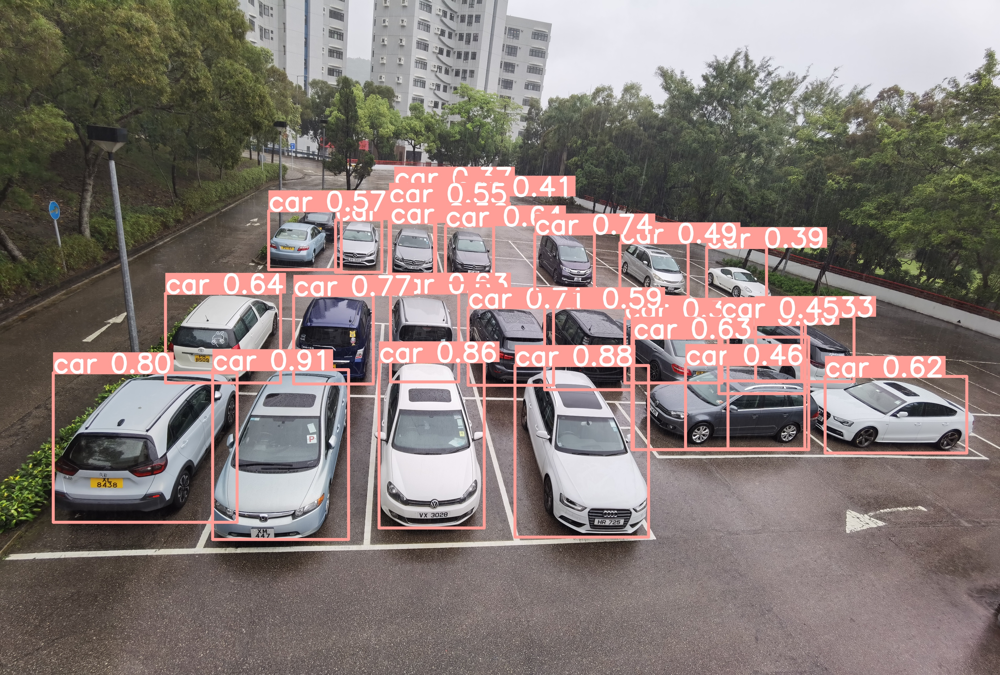

In [ ]:
import glob
from IPython.display import Image, display
display(Image(filename='/content/ultralytics/runs/detect/predict13/CarPark2.jpg', height=600))


Below is unmodified version, without any modification directly accuqire from online. !!!!!!!

In [ ]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 616.7/616.7 kB 9.5 MB/s eta 0:00:00


In [ ]:
from ultralytics import YOLO
import os
from IPython.display import display, Image
from IPython import display
display.clear_output()
!yolo checks

Ultralytics YOLOv8.0.151 🚀 Python-3.10.12 torch-2.0.1+cu118 CPU (AMD EPYC 7B12)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 24.4/225.8 GB disk)


In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="pmkUGz7MQtSv6f1R00aL")
project = rf.workspace("hkust-ozmhy").project("fyp-parking")
dataset = project.version(9).download("yolov8")

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.4/57.4 kB 1.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 155.3/155.3 kB 7.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 8.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 7.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 48.5/48.5 kB 6.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 6.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 50.8 MB/s eta 0:00:00
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9656 sha256=82b5b2f42d12e77215825008f7ad76f855c950f910dd33f564f2a828294989af
  Stored in directory: /root/.cache/pip/wheels/8b/f1/7f/5c94f0a7a505ca1c81cd1d9208ae2064675d97582078e6c769
Successfully built wget
  Attempting uninstall: pyparsing
    Found existing installation: pyparsing 3.1.0
    Uninstalling pyparsing-3.1.0:
      Su

loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics==8.0.134 is required but found version=8.0.145, to fix: `pip install ultralytics==8.0.134`

Extracting Dataset Version Zip to FYP-parking-9 in yolov8:: 100%|██████████| 1528/1528 [00:00<00:00, 2475.05it/s]


In [ ]:
!yolo task=detect mode=train model=yolov8n.pt data=/content/FYP-parking-9/data.yaml epochs=500 imgsz=640 lr0=0.0005

Ultralytics YOLOv8.0.145 🚀 Python-3.10.6 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/FYP-parking-9/data.yaml, epochs=500, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, line_width=None, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=False, optimize=False, int8=False, dynam

In [ ]:
!yolo task=detect mode=val model=/content/runs/detect/train3/weights/best.pt data={dataset.location}/data.yaml

Ultralytics YOLOv8.0.145 🚀 Python-3.10.6 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3006623 parameters, 0 gradients
val: Scanning /content/FYP-parking-9/valid/labels.cache... 163 images, 0 backgrounds, 0 corrupt: 100% 163/163 [00:00<?, ?it/s]
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 596, len(boxes) = 945. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 11/11 [00:06<00:00,  1.77it/s]
                   all        163        945      0.766      0.623      0.647      0.505
                   bus        163          2      0.691          1      0.995      0.846
                   car        163        938      0.606      0.827      0.787      0.608
            motorcycle        163          2          

In [ ]:
!yolo task=detect mode=predict model=/content/best-mobile-trial-one.pt conf=0.2 source=/content/CarPark2.jpg save_txt=true save_conf=true
#!yolo task=detect mode=predict model=yolov8n.pt conf=0.2 source=/content/CarPark2.jpg save_txt=true save_conf=true

Traceback (most recent call last):
  File "/usr/local/bin/yolo", line 8, in <module>
    sys.exit(entrypoint())
  File "/usr/local/lib/python3.10/dist-packages/ultralytics/cfg/__init__.py", line 396, in entrypoint
    model = YOLO(model, task=task)
  File "/usr/local/lib/python3.10/dist-packages/ultralytics/engine/model.py", line 94, in __init__
    self._load(model, task)
  File "/usr/local/lib/python3.10/dist-packages/ultralytics/engine/model.py", line 140, in _load
    self.model, self.ckpt = attempt_load_one_weight(weights)
  File "/usr/local/lib/python3.10/dist-packages/ultralytics/nn/tasks.py", line 622, in attempt_load_one_weight
    ckpt, weight = torch_safe_load(weight)  # load ckpt
  File "/usr/local/lib/python3.10/dist-packages/ultralytics/nn/tasks.py", line 561, in torch_safe_load
    return torch.load(file, map_location='cpu'), file  # load
  File "/usr/local/lib/python3.10/dist-packages/torch/serialization.py", line 809, in load
    return _load(opened_zipfile, map_locati

In [ ]:
!pip install torchvision onnx
!pip install onnxruntime
import torch.onnx as onnx

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.6/14.6 MB 38.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.9/5.9 MB 15.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 4.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 9.8 MB/s eta 0:00:00


In [ ]:
model = YOLO('/content/best-so-far.pt')  # load a custom trained

# Export the model
model.export(format='onnx')


AttributeError: ignored

In [ ]:
model = YOLO('/content/best-wth-yolo-8n.pt')  # load a custom trained

# Export the model
model.export(format='onnx')

Ultralytics YOLOv8.0.152 🚀 Python-3.10.12 torch-2.0.1+cu118 CPU (Intel Xeon 2.20GHz)
Model summary (fused): 168 layers, 3006623 parameters, 0 gradients

PyTorch: starting from '/content/best-wth-yolo-8n.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 9, 8400) (6.0 MB)

ONNX: starting export with onnx 1.14.0 opset 17...
ONNX: export success ✅ 1.2s, saved as '/content/best-wth-yolo-8n.onnx' (11.7 MB)

Export complete (3.3s)
Results saved to /content
Predict:         yolo predict task=detect model=/content/best-wth-yolo-8n.onnx imgsz=640 
Validate:        yolo val task=detect model=/content/best-wth-yolo-8n.onnx imgsz=640 data=/content/FYP-parking-9/data.yaml 
Visualize:       https://netron.app


============= Diagnostic Run torch.onnx.export version 2.0.1+cu118 =============
verbose: False, log level: Level.ERROR
======================= 0 NONE 0 NOTE 0 WARNING 0 ERROR ========================



'/content/best-wth-yolo-8n.onnx'

In [ ]:
!pip install opencv-python
!pip install numpy
!pip install onnxruntime

In [ ]:
import cv2
import numpy as np
import onnxruntime as ort

# Load the ONNX model
onnx_path = '/content/best-so-far.onnx'
session = ort.InferenceSession(onnx_path)

# Load and preprocess the image
image_path = '/content/CarPark2.jpg'
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
image = cv2.resize(image, (640, 640))  # Resize to match the model's input resolution
image = image.transpose((2, 0, 1))  # Change the channel order to (C, H, W)
image = np.expand_dims(image, axis=0)  # Add a batch dimension

# Perform inference
inputs = {'images': image}
outputs = session.run(None, inputs)

# Process the outputs
boxes = outputs[0]
labels = outputs[1]
scores = outputs[2]

# Display bounding boxes on the image
for box, label, score in zip(boxes, labels, scores):
    x1, y1, x2, y2 = box
    cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)
    cv2.putText(image, f'{label}: {score:.2f}', (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 255, 0), 2)

# Display the image
cv2.imshow('Result', image)

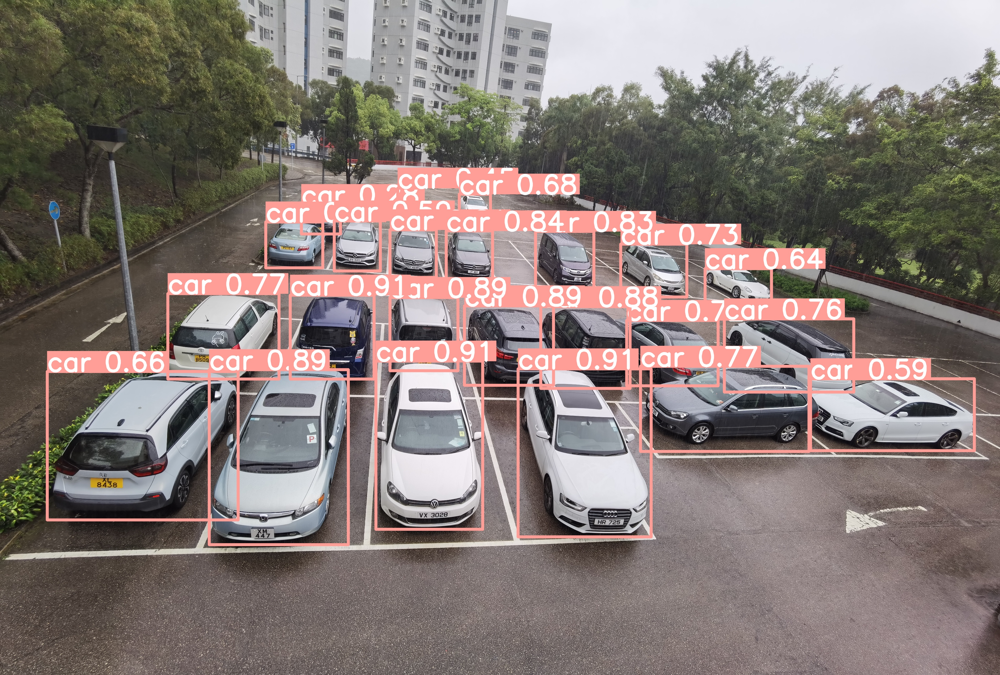

In [ ]:
import glob
from IPython.display import Image, display
display(Image(filename='/content/runs/detect/predict3/CarPark2.jpg', height=600))